In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input/pothole-image-segmentation-dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/README.dataset.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/README.roboflow.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/data.yaml
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/sample_video.mp4
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels/pic-269-_jpg.rf.196b54c0db633b6b02612f69072abb99.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels/pic-69-_jpg.rf.0fcb6cd22beb140d931a387036b7eab6.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels/pic-42-_jpg.rf.28b626ac5e887c92feeed1a3c5e85b64.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels/pic-273-_jpg.rf.36d10c68fb23799bd0a58e48e0b995ce.txt
/kaggle/input/pothole-image-segmentation-dataset/Pothole

1.setup 

In [2]:
# Install Ultralytics library
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.8/978.8 kB 17.6 MB/s eta 0:00:00a 0:00:01


In [3]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import cv2
import yaml
from PIL import Image
from collections import deque
from ultralytics import YOLO
from IPython.display import Video

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#ffe4de'}, style='darkgrid')

**2.Load YOLOv8-seg Model**

In [5]:
# Load the pre-trained YOLOv8 nano segmentation model
model = YOLO('yolov8n-seg.pt')

100%|██████████| 6.74M/6.74M [00:00<00:00, 89.9MB/s]


**3.Dataset Exploration**

In [6]:
# Define the dataset_path
dataset_path = '/kaggle/input/pothole-image-segmentation-dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Pothole
nc: 1
roboflow:
  license: CC BY 4.0
  project: pothole_segmentation_yolov8
  url: https://universe.roboflow.com/farzad/pothole_segmentation_yolov8/dataset/1
  version: 1
  workspace: farzad
train: ../train/images
val: ../valid/images



In [7]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/train', 'images')
valid_images_path = os.path.join(dataset_path, '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 720
Number of validation images: 60
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


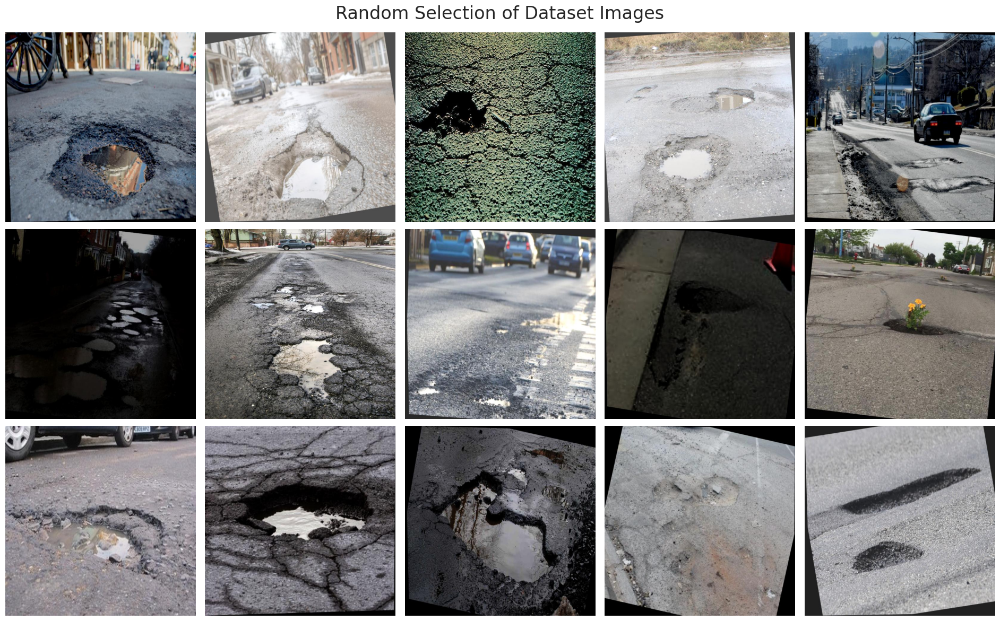

In [11]:
# Set the seed for the random number generator
random.seed(0)

# Create a list of image files
image_files = [f for f in os.listdir(train_images_path) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 15)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(train_images_path, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')
# Add a suptitle
plt.suptitle('Random Selection of Dataset Images', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

**4.Fine-tuning yolov8n**

In [9]:
import torch
print("CUDA Available:", torch.cuda.is_available())
print("CUDA Device Count:", torch.cuda.device_count())
print("CUDA Version:", torch.version.cuda)
print("Device Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU")


CUDA Available: True
CUDA Device Count: 1
CUDA Version: 12.1
Device Name: Tesla P100-PCIE-16GB


In [12]:
import torch
device = 0 if torch.cuda.is_available() else "cpu"  # Auto-select GPU if available

results = model.train(
    data=yaml_file_path,
    epochs=15,
    imgsz=640,
    patience=15,
    batch=16,
    optimizer='auto',
    lr0=0.0001,
    lrf=0.01,
    dropout=0.25,
    device=device,  # Auto GPU/CPU selection
    seed=42
)


Ultralytics 8.3.110 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/data.yaml, epochs=15, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.25, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, sav

train: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/train/labels... 720 images, 0 backgrounds, 0 corrupt: 100%|██████████| 720/720 [00:00<00:00, 742.51it/s]

train: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.8±0.9 ms, read: 166.2±59.1 MB/s, size: 98.1 KB)


val: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 358.98it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid is not writeable, cache not saved.


Plotting labels to runs/segment/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/segment/train2
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/15      5.35G      1.317      2.115      1.326      1.318         66        640: 100%|██████████| 45/45 [00:13<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.25it/s]

                   all         60        201      0.558      0.684      0.598       0.31      0.619      0.617      0.623      0.315



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/15      5.35G      1.296      2.069      1.238      1.302         59        640: 100%|██████████| 45/45 [00:12<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.27it/s]

                   all         60        201      0.607      0.577      0.583      0.301      0.617      0.586      0.587        0.3



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/15      5.35G        1.3      2.111      1.237      1.304         62        640: 100%|██████████| 45/45 [00:12<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.23it/s]

                   all         60        201      0.588      0.517      0.522      0.278      0.581      0.518      0.521      0.266



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/15      5.35G      1.298      2.073      1.215        1.3         68        640: 100%|██████████| 45/45 [00:12<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201      0.589      0.563      0.548      0.284      0.624      0.547      0.557       0.27



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/15      5.35G      1.303      2.055      1.186      1.304         65        640: 100%|██████████| 45/45 [00:12<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.17it/s]

                   all         60        201      0.615      0.637      0.627      0.342      0.721      0.567      0.633       0.33


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/15      5.36G      1.307      2.079       1.22      1.355         34        640: 100%|██████████| 45/45 [00:13<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201      0.593      0.657      0.624      0.345      0.614      0.656      0.635      0.336



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/15      5.36G      1.296      2.025      1.139      1.328         52        640: 100%|██████████| 45/45 [00:11<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.08it/s]

                   all         60        201      0.599      0.562      0.533       0.28      0.617      0.592      0.553      0.272



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/15      5.36G      1.266      2.015      1.099      1.314         48        640: 100%|██████████| 45/45 [00:11<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.27it/s]

                   all         60        201        0.7      0.582      0.641      0.351      0.687      0.562      0.618      0.321



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/15      5.36G      1.223      1.915     0.9848      1.283         34        640: 100%|██████████| 45/45 [00:11<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.37it/s]

                   all         60        201      0.588      0.552      0.581      0.337      0.601      0.567      0.592      0.333



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/15      5.36G      1.184      1.861     0.9683      1.252         39        640: 100%|██████████| 45/45 [00:11<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.34it/s]

                   all         60        201      0.665      0.672      0.697      0.393      0.695      0.657      0.703      0.392



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/15      5.36G      1.133      1.849     0.8822      1.218         42        640: 100%|██████████| 45/45 [00:11<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.28it/s]

                   all         60        201      0.682      0.592      0.665      0.397      0.656      0.632      0.654      0.365



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/15      5.36G      1.103      1.739     0.8525      1.194         44        640: 100%|██████████| 45/45 [00:11<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.20it/s]

                   all         60        201      0.733      0.706      0.712      0.423      0.749      0.721      0.738      0.412



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/15      5.36G      1.082      1.708     0.7848      1.174         45        640: 100%|██████████| 45/45 [00:11<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.38it/s]

                   all         60        201      0.789      0.559      0.661      0.402      0.817      0.578        0.7      0.395



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/15      5.36G      1.042      1.673     0.7552       1.15         34        640: 100%|██████████| 45/45 [00:11<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.37it/s]

                   all         60        201      0.792      0.622        0.7      0.425      0.798      0.627      0.723       0.41



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/15      5.36G      1.016      1.603     0.7251      1.133         61        640: 100%|██████████| 45/45 [00:11<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.34it/s]

                   all         60        201      0.702       0.67      0.732       0.44      0.708      0.675      0.738      0.429



15 epochs completed in 0.055 hours.
Optimizer stripped from runs/segment/train2/weights/last.pt, 6.8MB
Optimizer stripped from runs/segment/train2/weights/best.pt, 6.8MB

Validating runs/segment/train2/weights/best.pt...
Ultralytics 8.3.110 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-seg summary (fused): 85 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:00<00:00,  2.71it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]


                   all         60        201      0.702      0.667       0.73      0.441      0.707      0.672      0.738      0.429
Speed: 0.2ms preprocess, 4.0ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/segment/train2


**5.Model Performance Evaluation**

In [13]:
# Define the path to the directory
post_training_files_path = '/kaggle/working/runs/segment/train'

# List the files in the directory
!ls {post_training_files_path}

args.yaml					  train_batch1.jpg
events.out.tfevents.1744909619.4b0d19536b54.31.0  train_batch225.jpg
labels_correlogram.jpg				  train_batch226.jpg
labels.jpg					  train_batch227.jpg
results.csv					  train_batch2.jpg
train_batch0.jpg				  weights


Validation performance metric evaluation

In [14]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.110 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-seg summary (fused): 85 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs
val: Fast image access ✅ (ping: 0.7±0.5 ms, read: 206.4±133.0 MB/s, size: 93.2 KB)


val: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 648.68it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/4 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  25%|██▌       | 1/4 [00:00<00:02,  1.27it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  50%|█████     | 2/4 [00:01<00:01,  1.50it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.36it/s]


                   all         60        201      0.614      0.538      0.586      0.299       0.63      0.542      0.595      0.295
Speed: 5.4ms preprocess, 7.0ms inference, 0.1ms loss, 3.3ms postprocess per image
Results saved to runs/segment/val


In [15]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.614
metrics/recall(B),0.538
metrics/mAP50(B),0.586
metrics/mAP50-95(B),0.299
metrics/precision(M),0.630
metrics/recall(M),0.542
metrics/mAP50(M),0.595
metrics/mAP50-95(M),0.295
fitness,0.653


**Model testing**

****6.1 Test on validation image**###### **


image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-17-_jpg.rf.0d172b6accedf4c52a3868d9b690d48b.jpg: 640x640 4 Potholes, 6.8ms
Speed: 1.5ms preprocess, 6.8ms inference, 12.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-262-_jpg.rf.02970860794f859699c9f743bc0fd7d1.jpg: 640x640 1 Pothole, 7.1ms
Speed: 1.5ms preprocess, 7.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-60-_jpg.rf.4e715308cc8dc7455b767414cda028ab.jpg: 640x640 3 Potholes, 6.9ms
Speed: 1.3ms preprocess, 6.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-178-_jpg.rf.2e27d006aec1544f1eec88d9170fd6ce.jpg: 640x640 1 Pothol

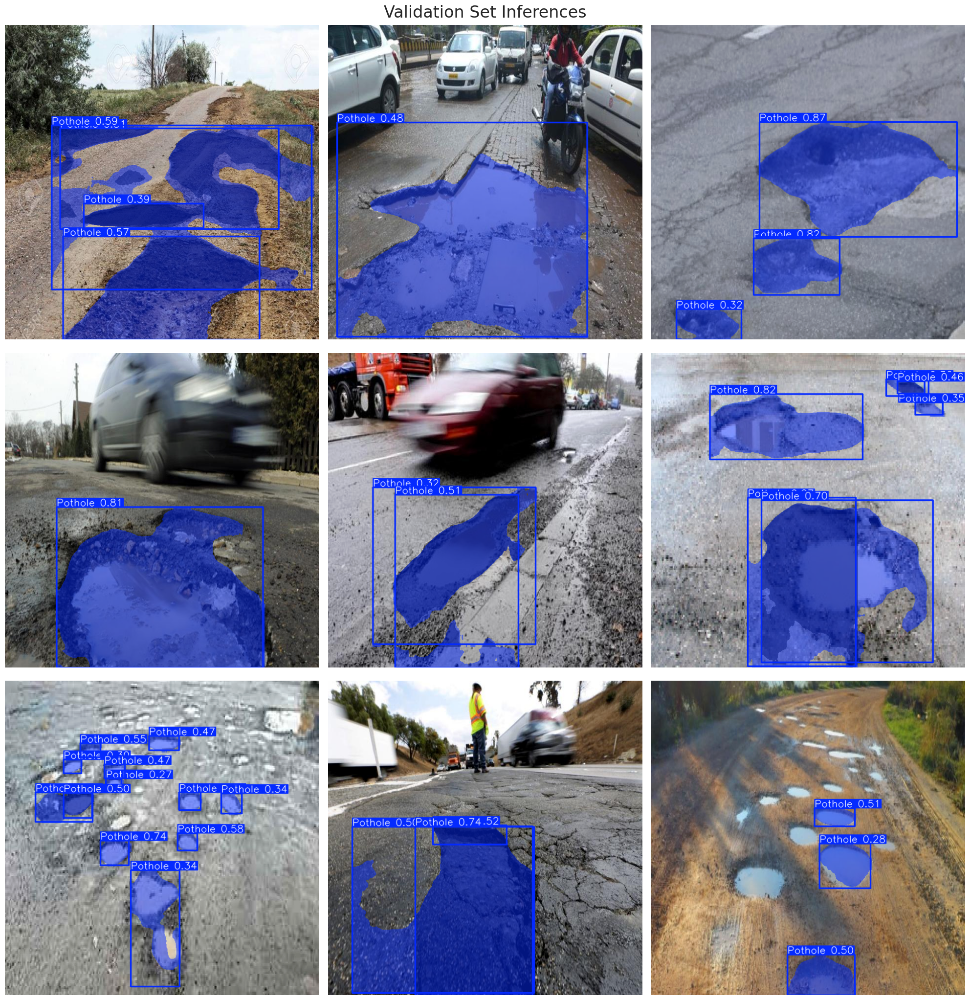

In [16]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640)
    annotated_image = results[0].plot()
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [17]:
# Define the path to the sample video in the dataset
dataset_video_path = '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/sample_video.mp4'

# Define the destination path in the working directory
video_path = '/kaggle/working/sample_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 44.3ms
video 1/1 (frame 2/375) /kaggle/working/sample_video.mp4: 384x640 5 Potholes, 8.2ms
video 1/1 (frame 3/375) /kaggle/working/sample_video.mp4: 384x640 4 Potholes, 7.6ms
video 1/1 (frame 4/375) /kaggle/working/sample_video.mp4: 384x640 4 Potholes, 7.7ms
video 1/1 (frame 5/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 7.4ms
video 1/1 (frame 6/375) /kaggle/wor

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'Pothole'}
 obb: None
 orig_img: array([[[146, 137, 129],
         [177, 168, 160],
         [178, 169, 161],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[197, 188, 180],
         [206, 197, 189],
         [164, 155, 147],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[150, 141, 133],
         [183, 174, 166],
         [188, 179, 171],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        ...,
 
        [[ 80,  92, 102],
         [ 70,  82,  92],
         [ 63,  75,  85],
         ...,
         [ 61,  81, 101],
         [ 62,  82, 102],
         [ 65,  85, 105]],
 
        [[ 70,  82,  92],
         [ 63,  75,  85],
         [ 59,  71,  8

In [18]:
# Convert the .avi video generated by the YOLOv8 prediction to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /kaggle/working/runs/segment/predict/sample_video.avi processed_sample_video.mp4

# Embed and display the processed sample video within the notebook
Video("processed_sample_video.mp4", embed=True, width=960)

In [ ]:
Save the model

In [ ]:
# Export the model
best_model.export(format='onnx')


**Realtime Road damage assessment**


image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-33-_jpg.rf.143c56d136e3245555b26b4d5108a4e1.jpg: 640x640 2 Potholes, 8.9ms
Speed: 1.8ms preprocess, 8.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


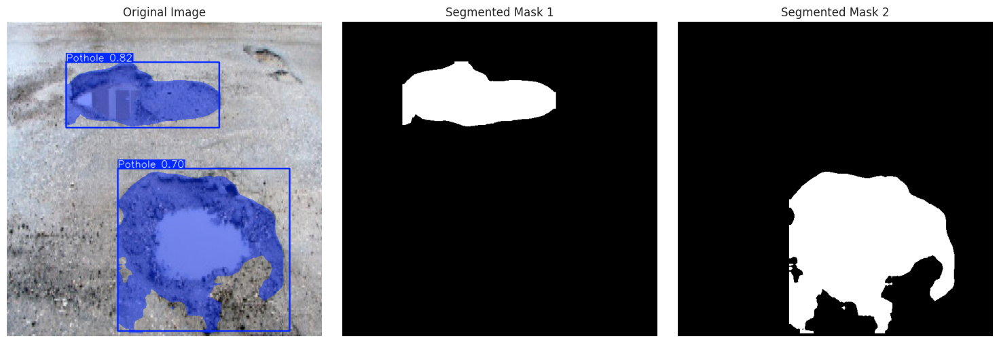

In [26]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select a sample image
selected_image = image_files[30]

# Perform inference on the selected image
image_path = os.path.join(valid_images_path, selected_image)
results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
annotated_image = results[0].plot()
annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)

# Determine the number of subplots needed (1 original + number of masks)
num_subplots = 1 + (len(results[0].masks.data) if results[0].masks is not None else 0)

# Initialize the subplot with 1 row and n columns
fig, axes = plt.subplots(1, num_subplots, figsize=(15, 5))

# Display the original annotated image
axes[0].imshow(annotated_image_rgb)
axes[0].set_title('Original Image')
axes[0].axis('off')

# If multiple masks, iterate and display each mask
if results[0].masks is not None:
    masks = results[0].masks.data.cpu().numpy()
    for i, mask in enumerate(masks):
        # Threshold the mask to make sure it's binary
        # Any value greater than 0 is set to 255, else it remains 0
        binary_mask = (mask > 0).astype(np.uint8) * 255
        axes[i+1].imshow(binary_mask, cmap='gray')
        axes[i+1].set_title(f'Segmented Mask {i+1}')
        axes[i+1].axis('off')

# Adjust layout and display the subplot
plt.tight_layout()
plt.show()

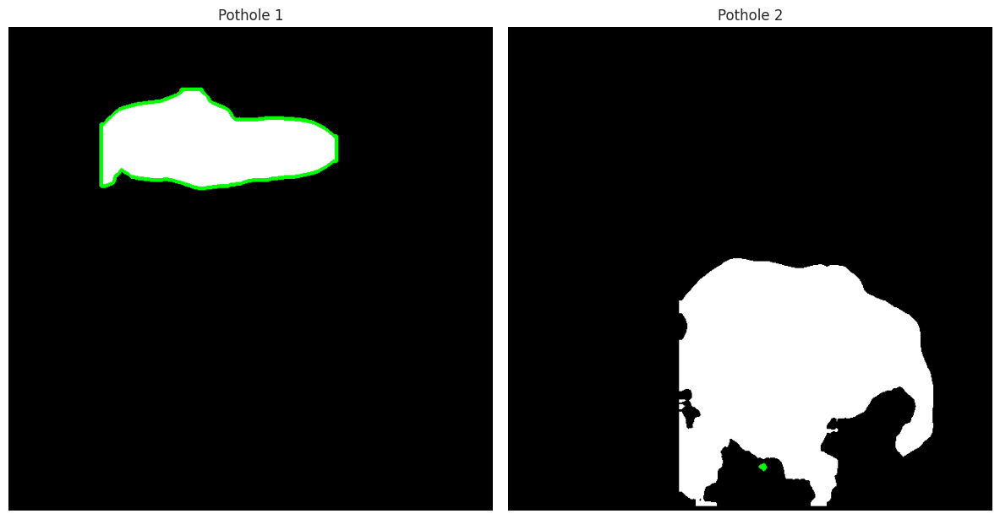

Area of Pothole 1: 28213.0 pixels
Area of Pothole 2: 20.5 pixels
--------------------------------------------------
Total Damaged Area by Potholes: 28233.5 pixels
Total Pixels in Image: 409600 pixels
Percentage of Road Damaged: 6.89%


In [27]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Initialize variables to hold total area and individual areas
total_area = 0
area_list = []

# Perform operations if masks are available
if results[0].masks is not None:
    masks = results[0].masks.data.cpu().numpy()   # Retrieve masks as numpy arrays
    image_area = masks.shape[1] * masks.shape[2]  # Calculate total number of pixels in the image
    
    # Set up the subplot dynamically based on the number of masks
    fig, axes = plt.subplots(1, len(masks), figsize=(12, 8))
    
    # Ensure `axes` is iterable even if there is only one mask
    if len(masks) == 1:
        axes = [axes]

    for i, mask in enumerate(masks):
        binary_mask = (mask > 0).astype(np.uint8) * 255  # Convert mask to binary
        color_mask = cv2.cvtColor(binary_mask, cv2.COLOR_GRAY2BGR)  # Convert binary mask to color
        contours, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:  # Ensure that at least one contour is found
            contour = contours[0]  # Retrieve the first contour
            area = cv2.contourArea(contour)  # Calculate the area of the pothole
            area_list.append(area)  # Append area to the list
            cv2.drawContours(color_mask, [contour], -1, (0, 255, 0), 3)  # Draw the contour on the mask

            # Display the mask with the green contour
            axes[i].imshow(color_mask)
            axes[i].set_title(f'Pothole {i+1}')
            axes[i].axis('off')

    # Display all masks
    plt.tight_layout()
    plt.show()

    # Calculate and print areas after displaying the images
    for i, area in enumerate(area_list):
        print(f"Area of Pothole {i+1}: {area} pixels")  
        total_area += area  # Sum the areas for total

    # Calculate and print the total damaged area and percentage of road damaged by potholes
    print("-"*50)
    print(f"Total Damaged Area by Potholes: {total_area} pixels")
    print(f"Total Pixels in Image: {image_area} pixels")
    print(f"Percentage of Road Damaged: {(total_area / image_area) * 100:.2f}%")


In [22]:
# Define the video path
video_path = '/kaggle/working/sample_video.mp4'

# Define font, scale, colors, and position for the annotation
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
text_position = (40, 80)
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Initialize a deque with fixed length for averaging the last 10 percentage damages
damage_deque = deque(maxlen=10)

# Open the video
cap = cv2.VideoCapture(video_path)

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('road_damage_assessment.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
     # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Perform inference on the frame
        results = best_model.predict(source=frame, imgsz=640, conf=0.25)
        processed_frame = results[0].plot(boxes=False)
        
        # Initializes percentage_damage to 0
        percentage_damage = 0 

         # If masks are available, calculate total damage area and percentage
        if results[0].masks is not None:
            total_area = 0
            masks = results[0].masks.data.cpu().numpy()
            image_area = frame.shape[0] * frame.shape[1]  # total number of pixels in the image
            for mask in masks:
                binary_mask = (mask > 0).astype(np.uint8) * 255
                contour, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                total_area += cv2.contourArea(contour[0])
            
            percentage_damage = (total_area / image_area) * 100

        # Calculate and update the percentage damage
        damage_deque.append(percentage_damage)
        smoothed_percentage_damage = sum(damage_deque) / len(damage_deque)
            
        # Draw a thick line for text background
        cv2.line(processed_frame, (text_position[0], text_position[1] - 10),
                 (text_position[0] + 350, text_position[1] - 10), background_color, 40)
        # Annotate the frame with the percentage of damage
        cv2.putText(processed_frame, f'Road Damage: {smoothed_percentage_damage:.2f}%', text_position, font, font_scale, font_color, 2, cv2.LINE_AA)         
    
        # Write the processed frame to the output video
        out.write(processed_frame)
        
        # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
        # cv2.imshow('Road Damage Assessment', processed_frame) # Display the processed frame
        # if cv2.waitKey(1) & 0xFF == ord('q'): # Press Q on keyboard to exit the loop
        #     break 
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()



0: 384x640 2 Potholes, 12.7ms
Speed: 2.9ms preprocess, 12.7ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 8.1ms
Speed: 1.7ms preprocess, 8.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 9.9ms
Speed: 1.6ms preprocess, 9.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 9.8ms
Speed: 1.7ms preprocess, 9.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 9.7ms
Speed: 1.7ms preprocess, 9.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 Potholes, 7.4ms
Speed: 1.7ms preprocess, 7.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 Potholes, 7.3ms
Speed: 1.6ms preprocess, 7.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 Potholes, 7.3ms
Speed: 1.5ms preprocess, 7.3ms inference, 1.8ms postprocess per image at shape (1, 3, 

In [23]:
# Convert the .avi video generated by our traffic density estimation app to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /kaggle/working/road_damage_assessment.avi road_damage_assessment.mp4

# Embed and display the processed sample video within the notebook
Video("road_damage_assessment.mp4", embed=True, width=960)

In [29]:
!pip install -q gradio onnxruntime


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.9/46.9 MB 40.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.2/322.2 kB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 92.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.5/11.5 MB 114.0 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 6.3 MB/s eta 0:00:00


In [30]:
import os
print(os.listdir("/kaggle/input"))


['data1-yaml', 'yolov8n-seg', 'testimage', 'pothole-image-segmentation-dataset']


In [31]:
import cv2
import numpy as np
import os
import torch
import gradio as gr
import matplotlib.pyplot as plt
from ultralytics import YOLO
from collections import deque

# ✅ Load YOLOv8 model
model_path = "/kaggle/working/runs/segment/train/weights/best.pt"
model = YOLO(model_path)

# ✅ Function to process images and analyze damage
def analyze_damage(image):
    orig_image = image.copy()
    h, w, _ = orig_image.shape

    # Perform inference
    results = model(image)

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            score = box.conf[0].item()
            if score > 0.5:
                cv2.rectangle(orig_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(orig_image, f"Pothole {score:.2f}", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # ✅ Calculate total damage area
    total_area = 0
    image_area = h * w  # Total image pixels

    if hasattr(results[0], 'masks') and results[0].masks is not None:
        masks = results[0].masks.data.cpu().numpy()
        for mask in masks:
            binary_mask = (mask > 0).astype(np.uint8) * 255
            contours, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                total_area += cv2.contourArea(contours[0])

    damage_percentage = (total_area / image_area) * 100 if image_area > 0 else 0

    return orig_image, f"🚧 Road Damage: {damage_percentage:.2f}% 🚧"

# ✅ Function to process videos
def process_video(video_path):
    cap = cv2.VideoCapture(video_path)
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter('/kaggle/working/road_damage_output.avi', fourcc, 20.0,
                          (int(cap.get(3)), int(cap.get(4))))
    
    damage_deque = deque(maxlen=10)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Run inference
        results = model(frame)
        processed_frame = results[0].plot(boxes=False)

        # Calculate road damage
        total_area = 0
        image_area = frame.shape[0] * frame.shape[1]

        if results[0].masks is not None:
            masks = results[0].masks.data.cpu().numpy()
            for mask in masks:
                binary_mask = (mask > 0).astype(np.uint8) * 255
                contours, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                if contours:
                    total_area += cv2.contourArea(contours[0])

        damage_percentage = (total_area / image_area) * 100 if image_area > 0 else 0
        damage_deque.append(damage_percentage)
        smoothed_damage = sum(damage_deque) / len(damage_deque)

        # Overlay damage percentage
        cv2.putText(processed_frame, f'Road Damage: {smoothed_damage:.2f}%', (40, 80),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        
        out.write(processed_frame)

    cap.release()
    out.release()
    return "/kaggle/working/road_damage_output.avi"

# 🎨 **Enhanced Gradio UI**
with gr.Blocks(title="Road Damage Assessment") as app:
    gr.Markdown("<h1 style='text-align: center; color: #4CAF50;'>🚧 Road Damage Detection & Assessment 🚧</h1>")
    gr.Markdown("### Upload an image or video to analyze road damage and pothole severity.")

    with gr.Tab("📸 Image Analysis"):
        with gr.Row():
            input_image = gr.Image(type="numpy", label="Upload Road Image")
            analyze_button = gr.Button("🔍 Analyze Damage")
        with gr.Row():
            output_image = gr.Image(type="numpy", label="Damage Analysis Output")
            damage_text = gr.Textbox(label="Damage Percentage", interactive=False)
        analyze_button.click(analyze_damage, inputs=input_image, outputs=[output_image, damage_text])

    with gr.Tab("🎥 Video Analysis"):
        with gr.Row():
            input_video = gr.Video(label="Upload Road Video")
            analyze_video_button = gr.Button("🎬 Process Video")
        with gr.Row():
            output_video = gr.Video(label="Processed Video Output")
        analyze_video_button.click(process_video, inputs=input_video, outputs=output_video)

# 🚀 Launch UI
app.launch()


* Running on local URL:  http://127.0.0.1:7860
It looks like you are running Gradio on a hosted a Jupyter notebook. For the Gradio app to work, sharing must be enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

* Running on public URL: https://2a4bb895cae4fb9c50.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)



0: 640x640 1 Pothole, 8.7ms
Speed: 2.9ms preprocess, 8.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


In [27]:
import cv2
import numpy as np
import os
import torch
import gradio as gr
import matplotlib.pyplot as plt
from ultralytics import YOLO
from collections import deque

# ✅ Load YOLOv8 model
model_path = "/kaggle/working/runs/segment/train/weights/best.pt"
model = YOLO(model_path)

# ✅ Function to process images and analyze damage
def analyze_damage(image):
    orig_image = image.copy()
    h, w, _ = orig_image.shape

    # Perform inference
    results = model(image)

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            score = box.conf[0].item()
            if score > 0.5:
                cv2.rectangle(orig_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(orig_image, f"Pothole {score:.2f}", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # ✅ Calculate total damage area
    total_area = 0
    image_area = h * w  # Total image pixels

    if hasattr(results[0], 'masks') and results[0].masks is not None:
        masks = results[0].masks.data.cpu().numpy()
        for mask in masks:
            binary_mask = (mask > 0).astype(np.uint8) * 255
            contours, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                total_area += cv2.contourArea(contours[0])

    damage_percentage = (total_area / image_area) * 100 if image_area > 0 else 0

    return orig_image, f"🚧 Road Damage: {damage_percentage:.2f}% 🚧"

# ✅ Function to process videos
def process_video(video_path):
    cap = cv2.VideoCapture(video_path)
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter('/kaggle/working/road_damage_output.avi', fourcc, 20.0,
                          (int(cap.get(3)), int(cap.get(4))))
    
    damage_deque = deque(maxlen=10)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Run inference
        results = model(frame)
        processed_frame = results[0].plot(boxes=False)

        # Calculate road damage
        total_area = 0
        image_area = frame.shape[0] * frame.shape[1]

        if results[0].masks is not None:
            masks = results[0].masks.data.cpu().numpy()
            for mask in masks:
                binary_mask = (mask > 0).astype(np.uint8) * 255
                contours, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                if contours:
                    total_area += cv2.contourArea(contours[0])

        damage_percentage = (total_area / image_area) * 100 if image_area > 0 else 0
        damage_deque.append(damage_percentage)
        smoothed_damage = sum(damage_deque) / len(damage_deque)

        # Overlay damage percentage
        cv2.putText(processed_frame, f'Road Damage: {smoothed_damage:.2f}%', (40, 80),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        
        out.write(processed_frame)

    cap.release()
    out.release()
    return "/kaggle/working/road_damage_output.avi"

# 🎨 **Enhanced Gradio UI**
with gr.Blocks(title="Road Damage Assessment") as app:
    gr.Markdown("""
        # 🚧 Road Damage Detection & Assessment 🚧
        Upload an image or video to analyze road damage and pothole severity.
    """)

    with gr.Tab("📸 Image Analysis"):
        gr.Markdown("### Upload an image to detect potholes and assess damage severity.")
        with gr.Row():
            input_image = gr.Image(type="numpy", label="Upload Road Image")
            analyze_button = gr.Button("🔍 Analyze Damage", variant="primary")
        with gr.Row():
            output_image = gr.Image(type="numpy", label="Damage Analysis Output")
            damage_text = gr.Textbox(label="Damage Percentage", interactive=False)
        analyze_button.click(analyze_damage, inputs=input_image, outputs=[output_image, damage_text])

    with gr.Tab("🎥 Video Analysis"):
        gr.Markdown("### Upload a video for real-time road damage detection.")
        with gr.Row():
            input_video = gr.Video(label="Upload Road Video")
            analyze_video_button = gr.Button("🎬 Process Video", variant="primary")
        with gr.Row():
            output_video = gr.Video(label="Processed Video Output")
        analyze_video_button.click(process_video, inputs=input_video, outputs=output_video)

# 🚀 Launch UI
app.launch(share=True)


* Running on local URL:  http://127.0.0.1:7861
* Running on public URL: https://6d18a99082f036039b.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
